In [4]:
%load_ext autoreload
%autoreload 2

In [174]:
import os
import pathlib
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
import re
import shutil
import pandas as pd
import scipy.stats
import quantities as pq

import exdir
import expipe
from distutils.dir_util import copy_tree
import septum_mec
import spatial_maps as sp
import head_direction.head as head
import septum_mec.analysis.data_processing as dp
import septum_mec.analysis.registration
from septum_mec.analysis.plotting import violinplot, despine
from spatial_maps.fields import (
    find_peaks, calculate_field_centers, separate_fields_by_laplace, 
    map_pass_to_unit_circle, calculate_field_centers, distance_to_edge_function, 
    compute_crossings, which_field)
from phase_precession import cl_corr
#from spike_statistics.core import permutation_resampling
import matplotlib.mlab as mlab
import scipy.signal as ss
from scipy.interpolate import interp1d
from septum_mec.analysis.plotting import regplot
from skimage import measure
from tqdm.notebook import tqdm_notebook as tqdm
tqdm.pandas()

from scipy.stats import wilcoxon

In [175]:
%matplotlib widget
#%matplotlib inline

In [7]:
project_path = dp.project_path()
project = expipe.get_project(project_path)
actions = project.actions

output_path = pathlib.Path("output") / "spikes-in-field-in-between"
(output_path / "statistics").mkdir(exist_ok=True, parents=True)
(output_path / "figures").mkdir(exist_ok=True, parents=True)

# Load cell statistics and shuffling quantiles

In [8]:
statistics_action = actions['calculate-statistics']
identification_action = actions['identify-neurons']
sessions = pd.read_csv(identification_action.data_path('sessions'))
units = pd.read_csv(identification_action.data_path('units'))
session_units = pd.merge(sessions, units, on='action')
statistics_results = pd.read_csv(statistics_action.data_path('results'))
statistics = pd.merge(session_units, statistics_results, how='left')
statistics.head()

,action,baseline,entity,frequency,i,ii,session,stim_location,stimulated,tag,...,gridness,border_score,information_rate,information_specificity,head_mean_ang,head_mean_vec_len,spacing,orientation,field_area,theta_score
0,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,-0.466836,0.029328,1.009215,0.317256,5.438033,0.040874,0.628784,69.775141,0.412306,-0.430279
1,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,-0.666792,0.308146,0.192524,0.033447,1.951740,0.017289,0.789388,62.102729,0.432396,0.307692
2,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,-0.571614,0.143252,4.745836,0.393704,4.439721,0.124731,0.555402,61.189206,0.468221,-0.059705
3,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,-0.428802,0.268948,0.157394,0.073553,6.215195,0.101911,0.492250,4.969741,0.425901,0.132632
4,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,-0.083406,0.218744,0.519153,0.032683,1.531481,0.053810,0.559905,0.000000,0.395395,0.218721


In [9]:
statistics['unit_day'] = statistics.apply(lambda x: str(x.unit_idnum) + '_' + x.action.split('-')[1], axis=1)

In [10]:
stim_response_action = actions['stimulus-response']
stim_response_results = pd.read_csv(stim_response_action.data_path('results'))

In [11]:
statistics = pd.merge(statistics, stim_response_results, how='left')

In [12]:
print('N cells:',statistics.shape[0])

N cells: 1284


In [13]:
shuffling = actions['shuffling']
quantiles_95 = pd.read_csv(shuffling.data_path('quantiles_95'))
quantiles_95.head()

,border_score,gridness,head_mean_ang,head_mean_vec_len,information_rate,speed_score,action,channel_group,unit_name
0,0.348023,0.275109,3.012689,0.086792,0.707197,0.149071,1833-010719-1,0.0,127.0
1,0.362380,0.166475,3.133138,0.037271,0.482486,0.132212,1833-010719-1,0.0,161.0
2,0.367498,0.266865,5.586395,0.182843,0.271188,0.062821,1833-010719-1,0.0,191.0
3,0.331942,0.312155,5.955767,0.090786,0.354018,0.052009,1833-010719-1,0.0,223.0
4,0.325842,0.180495,5.262721,0.103584,0.210427,0.094041,1833-010719-1,0.0,225.0


In [14]:
action_columns = ['action', 'channel_group', 'unit_name']
data = pd.merge(statistics, quantiles_95, on=action_columns, suffixes=("", "_threshold"))

data['specificity'] = np.log10(data['in_field_mean_rate'] / data['out_field_mean_rate'])

data.head()

,action,baseline,entity,frequency,i,ii,session,stim_location,stimulated,tag,...,p_e_peak,t_i_peak,p_i_peak,border_score_threshold,gridness_threshold,head_mean_ang_threshold,head_mean_vec_len_threshold,information_rate_threshold,speed_score_threshold,specificity
0,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.332548,0.229073,6.029431,0.205362,1.115825,0.066736,0.451741
1,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.354830,0.089333,6.120055,0.073566,0.223237,0.052594,0.098517
2,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.264610,-0.121081,5.759406,0.150827,4.964984,0.027120,0.400770
3,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.344280,0.215829,6.033364,0.110495,0.239996,0.054074,0.269461
4,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.342799,0.218967,5.768170,0.054762,0.524990,0.144702,0.133410


# Statistics about all cell-sessions

In [15]:
#data.groupby('stimulated').count()['action']
# only use stimulated sessions
data_stim = data[data.stimulated == True]

In [16]:
print(len(data), len(data_stim))

1284 660


# Find all cells with gridness above threshold

In [17]:
query = (
    'gridness > gridness_threshold and '
    'information_rate > information_rate_threshold and '
    'gridness > .2 and '
    'average_rate < 25'
)
sessions_above_threshold = data_stim.query(query)
print("Number of sessions above threshold", len(sessions_above_threshold))
print("Number of animals", len(sessions_above_threshold.groupby(['entity'])))

Number of sessions above threshold 82
Number of animals 4


## select neurons that have been characterized as a grid cell on the same day

In [18]:
once_a_gridcell = statistics[statistics.unit_day.isin(sessions_above_threshold.unit_day.values)]

In [19]:
print("Number of gridcells", once_a_gridcell.unit_idnum.nunique())
print("Number of gridcell recordings", len(once_a_gridcell))
print("Number of animals", len(once_a_gridcell.groupby(['entity'])))

Number of gridcells 68
Number of gridcell recordings 128
Number of animals 4


# divide into stim not stim

In [20]:
baseline_i = once_a_gridcell.query('baseline and Hz11')
stimulated_11 = once_a_gridcell.query('stimulated and frequency==11 and stim_location=="ms"')

baseline_ii = once_a_gridcell.query('baseline and Hz30')
stimulated_30 = once_a_gridcell.query('stimulated and frequency==30 and stim_location=="ms"')

print("Number of gridcells in baseline i sessions", len(baseline_i))
print("Number of gridcells in stimulated 11Hz ms sessions", len(stimulated_11))

print("Number of gridcells in baseline ii sessions", len(baseline_ii))
print("Number of gridcells in stimulated 30Hz ms sessions", len(stimulated_30))

Number of gridcells in baseline i sessions 16
Number of gridcells in stimulated 11Hz ms sessions 50
Number of gridcells in baseline ii sessions 21
Number of gridcells in stimulated 30Hz ms sessions 35


In [21]:
baseline_ids = baseline_i.unit_day.unique()

In [22]:
baseline_ids

array(['31_260619', '32_260619', '47_010719', '121_010719', '106_050619',
       '168_050619', '232_050619', '361_010319', '168_120619',
       '233_120619', '332_060319', '655_060619', '715_110319',
       '58_020719', '253_200619', '304_200619'], dtype=object)

In [23]:
stimulated_11_sub = stimulated_11[stimulated_11.unit_day.isin(baseline_ids)]

In [24]:
baseline_ids_11 = stimulated_11_sub.unit_day.unique()

In [25]:
baseline_i_sub = baseline_i[baseline_i.unit_day.isin(baseline_ids_11)]

# Plotting

In [26]:
max_speed = .5 # m/s only used for speed score
min_speed = 0.02 # m/s only used for speed score
position_sampling_rate = 100 # for interpolation
position_low_pass_frequency = 6 # for low pass filtering of position

box_size = [1.0, 1.0]
bin_size = 0.02
smoothing_low = 0.03
smoothing_high = 0.06

speed_binsize = 0.02

stim_mask = True
baseline_duration = 600

In [27]:
data_loader = dp.Data(
    position_sampling_rate=position_sampling_rate, 
    position_low_pass_frequency=position_low_pass_frequency,
    box_size=box_size, bin_size=bin_size, 
    stim_mask=stim_mask, baseline_duration=baseline_duration
)

In [28]:
def find_grid_fields(rate_map, sigma=3, seed=2.5):
    # find fields with laplace
    fields_laplace = sp.fields.separate_fields_by_dilation(rate_map, sigma=sigma, seed=seed)
    fields = fields_laplace.copy() # to be cleaned by Ismakov
    fields_areas = scipy.ndimage.measurements.sum(
        np.ones_like(fields), fields, index=np.arange(fields.max() + 1))
    fields_area = fields_areas[fields]
    fields[fields_area < 9.0] = 0

    # find fields with Ismakov-method
    fields_ismakov, radius = sp.separate_fields_by_distance(rate_map)
    fields_ismakov_real = fields_ismakov * bin_size
    approved_fields = []

    # remove fields not found by both methods
    for point in fields_ismakov:
        field_id = fields[tuple(point)]
        approved_fields.append(field_id)

    for field_id in np.arange(1, fields.max() + 1):
        if not field_id in approved_fields:
            fields[fields == field_id] = 0
            
    return fields

In [29]:
def get_data(row):
    spikes = data_loader.spike_train(row.action, row.channel_group, row.unit_name)
    rate_map = data_loader.rate_map(row.action, row.channel_group, row.unit_name, smoothing=0.04)
    pos_x, pos_y, pos_t, pos_speed = map(data_loader.tracking(row.action).get, ['x', 'y', 't', 'v'])
    stim_times = data_loader.stim_times(row.action)
    if stim_times is not None:
        stim_times = np.array(stim_times)
    spikes = np.array(spikes)
    spikes = spikes[(spikes > pos_t.min()) & (spikes < pos_t.max())]
#     sx, sy = rate_map.shape
#     dx = box_size[0] / sx
#     dy = box_size[1] / sy
#     x_bins = np.arange(0, box_size[0], dx)
#     y_bins = np.arange(0, box_size[1], dy)
#     f = interp2d(x_bins, y_bins, rate_map.T)
#     x_new = np.arange(0, box_size[0], dx / 3)
#     y_new = np.arange(0, box_size[1], dy / 3)
#     rate_map = f(x_new, y_new).T
    fields = find_grid_fields(rate_map)
    
    return spikes, pos_x, pos_y, pos_t, rate_map, fields, stim_times

In [30]:
def compute_field_spikes(row, plot=False, z1=5e-3, z2=11e-3, surrogate_fields=None):
    spikes, pos_x, pos_y, pos_t, rate_map, fields, stim_times = get_data(row)
    if surrogate_fields is not None:
        fields = surrogate_fields
#     if field_num is not None:
#         fields = np.where(fields == field_num, fields, 0)
        
    if plot:
        fig, axs = plt.subplots(1, 3, figsize=(16,9))
        axs[1].set_title(f'{row.action} {row.channel_group} {row.unit_idnum}, G={row.gridness:.3f}')
        dot_size = 10
        
    sx, sy = interp1d(pos_t, pos_x), interp1d(pos_t, pos_y)
    
    stim_spikes = []
    stim_in_field_indices = []
    # set z1 and z2 to be after the response: z1=12e3 - z2=60e3
    if stim_times is not None:
        for t in stim_times:
            idx = np.searchsorted(spikes, [t + z1, t + z2], side='right')
            tmp_spikes = spikes[idx[0]: idx[1]].tolist()
            stim_spikes.extend(tmp_spikes)
        stim_spikes_x = sx(stim_spikes)
        stim_spikes_y = sy(stim_spikes)
        stim_in_field_indices = which_field(stim_spikes_x, stim_spikes_y, fields, box_size).astype(bool)
        
#         stim_ids_ = []
#         stim_spikes_ = []
#         for i, t in enumerate(stim_times):
#             idx = np.searchsorted(spikes, [t, t + 30e-3], side='right')
#             tmp_spikes = (spikes[idx[0]: idx[1]] - t).tolist()
#             stim_ids_.extend([i] * len(tmp_spikes))
#             stim_spikes_.extend(tmp_spikes)
            
#         plt.scatter(stim_spikes_, stim_ids_, s=1)
#         plt.axvspan(z1, z2, color='r', alpha=.3)

    spikes_x = sx(spikes)
    spikes_y = sy(spikes)
    in_field_indices = which_field(spikes_x, spikes_y, fields, box_size).astype(bool)        
    
    if plot:
        axs[0].imshow(
            fields.T.astype(bool), extent=[0, box_size[0], 0, box_size[1]], 
            origin='lower', cmap=plt.cm.Greys, zorder=0)
        axs[0].scatter(
            spikes_x[in_field_indices], spikes_y[in_field_indices], 
            s=dot_size, color='r', zorder=1)
        axs[0].scatter(
            spikes_x[~in_field_indices], spikes_y[~in_field_indices], 
            s=dot_size, color='b', zorder=1)
        if stim_times is not None:
            axs[0].scatter(
                stim_spikes_x, stim_spikes_y,
                s=dot_size, color='orange', zorder=1)
        # Display the image and plot all contours found
        contours = measure.find_contours(fields, 0.0)
        axs[1].imshow(rate_map.T, extent=[0, box_size[0], 0, box_size[1]], origin='lower')

        axs[2].plot(pos_x, pos_y, color='k', alpha=.2, zorder=0)
        axs[2].scatter(
            interp1d(pos_t, pos_x)(spikes), interp1d(pos_t, pos_y)(spikes), 
            s=dot_size, zorder=1)

        for ax in axs.ravel()[1:]:
            for n, contour in enumerate(contours):
                ax.plot(
                    contour[:, 0] * bin_size, contour[:, 1] * bin_size, 
                    lw=4, color='y', zorder=3)

        for ax in axs.ravel():
            ax.axis('image')
            ax.set_xticks([])
            ax.set_yticks([])
    return fields, in_field_indices, stim_in_field_indices

In [161]:
def compute_field_spikes_in_between(row, z1_base=-5e-3, z2_base=5e-3, z1_stim=-5e-3, z2_stim=11e-3, z1_between=15e-3, z2_between=5e-3,  plot=False, surrogate_fields=None):
    '''
    Computes % of in field spikes in between stimulations.
    
    Parameters
    ----------
    z1: float
        Time in ms after the stimulation trigger to cut out non-stimulated spike trains
    z2: float
        Time in ms before the next stimulation trigger to cut out non-stimulated spike trains
    '''
    spikes, pos_x, pos_y, pos_t, rate_map, fields, stim_times = get_data(row)
    if surrogate_fields is not None:
        fields = surrogate_fields
#     if field_num is not None:
#         fields = np.where(fields == field_num, fields, 0)
        
    if plot:
        fig, axs = plt.subplots(1, 3, figsize=(16,9))
        axs[1].set_title(f'{row.action} {row.channel_group} {row.unit_idnum}, G={row.gridness:.3f}')
        dot_size = 10
        
    sx, sy = interp1d(pos_t, pos_x), interp1d(pos_t, pos_y)
    
    base_spikes = []
    base_in_filed_indices = []
    if stim_times is not None:
        for t in stim_times:
            idx = np.searchsorted(spikes, [t + z1_base, t + z2_base], side='right')
            tmp_spikes = spikes[idx[0]: idx[1]].tolist()
            base_spikes.extend(tmp_spikes)
        base_spikes_x = sx(base_spikes)
        base_spikes_y = sy(base_spikes)
        base_in_filed_indices = which_field(base_spikes_x, base_spikes_y, fields, box_size).astype(bool)
    else:
        raise Exception("To use 'in_between' the action should be a 'stimulated' action")
    
    stim_spikes = []
    stim_in_field_indices = []
    # set z1 and z2 to be after the response: z1=12e3 - z2=60e3
    for t in stim_times:
        idx = np.searchsorted(spikes, [t + z1_stim, t + z2_stim], side='right')
        tmp_spikes = spikes[idx[0]: idx[1]].tolist()
        stim_spikes.extend(tmp_spikes)
    stim_spikes_x = sx(stim_spikes)
    stim_spikes_y = sy(stim_spikes)
    stim_in_field_indices = which_field(stim_spikes_x, stim_spikes_y, fields, box_size).astype(bool)
    
    in_between_spikes = []
    in_field_indices_in_between = []
    for i, t in enumerate(stim_times[:-1]):
        idx = np.searchsorted(spikes, [t + z1_between, stim_times[i + 1] - z2_between], side='right')
        tmp_spikes = spikes[idx[0]:idx[1]].tolist()
        in_between_spikes.extend(tmp_spikes)
    in_between_spikes_x = sx(in_between_spikes)
    in_between_spikes_y = sy(in_between_spikes)
    in_between_in_field_indices = which_field(in_between_spikes_x, in_between_spikes_y, fields, box_size).astype(bool)
    
        
    if plot:
        axs[0].imshow(
            fields.T.astype(bool), extent=[0, box_size[0], 0, box_size[1]], 
            origin='lower', cmap=plt.cm.Greys, zorder=0)
        axs[0].scatter(
            base_spikes_x[base_in_filed_indices], base_spikes_y[base_in_filed_indices], 
            s=dot_size, color='r', zorder=1)
        axs[0].scatter(
            base_spikes_x[~base_in_filed_indices], base_spikes_y[~base_in_filed_indices], 
            s=dot_size, color='b', zorder=1)
        axs[0].scatter(
            in_between_spikes_x, in_between_spikes_y,
            s=dot_size // 2, color='green', zorder=1)
        axs[0].scatter(
            stim_spikes_x, stim_spikes_y,
            s=dot_size // 2, color='y', zorder=1)
        # Display the image and plot all contours found
        contours = measure.find_contours(fields, 0.0)
        axs[1].imshow(rate_map.T, extent=[0, box_size[0], 0, box_size[1]], origin='lower')

        axs[2].plot(pos_x, pos_y, color='k', alpha=.2, zorder=0)
        axs[2].scatter(
            interp1d(pos_t, pos_x)(spikes), interp1d(pos_t, pos_y)(spikes), 
            s=dot_size, zorder=1)

        for ax in axs.ravel()[1:]:
            for n, contour in enumerate(contours):
                ax.plot(
                    contour[:, 0] * bin_size, contour[:, 1] * bin_size, 
                    lw=4, color='y', zorder=3)

        for ax in axs.ravel():
            ax.axis('image')
            ax.set_xticks([])
            ax.set_yticks([])
    return fields, base_in_filed_indices, in_between_in_field_indices, stim_in_field_indices

In [32]:
def plot_stim_field_spikes(row, t1=0, t2=30, z1_base=0, z2_base=5, z1_stim=5, z2_stim=11, colors=['k','r']):
    spikes, pos_x, pos_y, pos_t, rate_map, fields, stim_times = get_data(row)
    spikes = np.array(spikes) * 1000
    pos_t = np.array(pos_t) * 1000
    stim_times = np.array(stim_times) * 1000
    
    fig, axs = plt.subplots(1, 2)
    dot_size = 2
        
    sx, sy = interp1d(pos_t, pos_x), interp1d(pos_t, pos_y)
    
    stim_spikes_base = []
    stim_spikes_base_plot = []
    stim_ids_base = []
    stim_spikes_stim = []
    stim_spikes_stim_plot = []
    stim_ids_stim = []
    stim_ids_all = []
    stim_spikes_all = []
    for i, t in enumerate(stim_times):
        idx = np.searchsorted(spikes, [t + z1_base, t + z2_base], side='right')
        tmp_spikes = spikes[idx[0]: idx[1]] - t
        stim_ids_base.extend([i] * len(tmp_spikes))
        stim_spikes_base_plot.extend(tmp_spikes)
        stim_spikes_base.extend(spikes[idx[0]: idx[1]].tolist())
        
        idx = np.searchsorted(spikes, [t + z1_stim, t + z2_stim], side='right')
        tmp_spikes = spikes[idx[0]: idx[1]] - t
        stim_ids_stim.extend([i] * len(tmp_spikes))
        stim_spikes_stim_plot.extend(tmp_spikes)
        stim_spikes_stim.extend(spikes[idx[0]: idx[1]].tolist())
        
        idx = np.searchsorted(spikes, [t + t1, t + t2], side='right')
        tmp_spikes = (spikes[idx[0]: idx[1]] - t).tolist()
        stim_ids_all.extend([i] * len(tmp_spikes))
        stim_spikes_all.extend(tmp_spikes)
    
        
    stim_spikes_base_x = sx(stim_spikes_base)
    stim_spikes_base_y = sy(stim_spikes_base)
#     stim_in_field_indices_base = which_field(
#         stim_spikes_base_x, stim_spikes_base_y, fields, box_size).astype(bool)
    
    stim_spikes_stim_x = sx(stim_spikes_stim)
    stim_spikes_stim_y = sy(stim_spikes_stim)
#     stim_in_field_indices_stim = which_field(
#         stim_spikes_stim_x, stim_spikes_stim_y, fields, box_size).astype(bool)


    axs[0].scatter(stim_spikes_all, stim_ids_all, s=dot_size, color='k', alpha=.5)
    axs[0].scatter(stim_spikes_base_plot, stim_ids_base, s=dot_size, color=colors[0], alpha=.8)
    axs[0].scatter(stim_spikes_stim_plot, stim_ids_stim, s=dot_size, color=colors[1], alpha=.8)
    
    times = np.arange(t1, t2, .1)
    from scipy.stats import gaussian_kde
    kernel = gaussian_kde(stim_spikes_all, 0.1)
    pdf = kernel(times)
    m = max(stim_ids_all)
    pdf = (pdf - pdf.min()) / (pdf - pdf.min()).max() * m
    axs[0].plot(times, pdf, 'k', lw=1)
    axs[0].set_xlim(t1, t2)
#     ax.plot(0, len(trials) * 1.1, ls='none', marker='v', color='k', markersize=5)
#     axs[0].axvspan(0, 5, color='#43a2ca', alpha=.3, zorder=-5)

    contours = measure.find_contours(fields, 0.0)

    axs[1].scatter(
        stim_spikes_base_x, stim_spikes_base_y,
        s=dot_size, color=colors[0], zorder=1, alpha=.8)
    
    axs[1].scatter(
        stim_spikes_stim_x, stim_spikes_stim_y,
        s=dot_size, color=colors[1], zorder=1, alpha=.8)

    axs[1].plot(pos_x, pos_y, color='k', alpha=.2, zorder=0)

    for n, contour in enumerate(contours):
        axs[1].plot(
            contour[:, 0] * bin_size, contour[:, 1] * bin_size, 
            lw=1, color='k', zorder=3)
    axs[0].set_aspect((t2 - t1) / len(stim_times))
    axs[1].axis('image')
    axs[1].set_xticks([])
    axs[1].set_yticks([])
    despine(axs[0])
    despine(axs[1], left=True, bottom=True)


In [145]:
def plot_stim_field_spikes_in_between(row, t1=-20, t2=100, z1_base=-5, z2_base=5, z1_stim=5, z2_stim=11, z1_between=15, z2_between=5, 
                                      colors=['k','r', 'g']):
    from scipy.stats import gaussian_kde
    spikes, pos_x, pos_y, pos_t, rate_map, fields, stim_times = get_data(row)
    spikes = np.array(spikes) * 1000
    pos_t = np.array(pos_t) * 1000
    stim_times = np.array(stim_times) * 1000
    
    fig, axs = plt.subplots(1, 2)
    dot_size = 2
        
    sx, sy = interp1d(pos_t, pos_x), interp1d(pos_t, pos_y)
    
    stim_frequency = np.round(1 / np.median(np.diff(stim_times)) * 1000)
    print(f"Stim frequency = {stim_frequency}Hz")
    
    stim_spikes_base = []
    stim_spikes_base_plot = []
    stim_ids_base = []
    stim_spikes_stim = []
    stim_spikes_stim_plot = []
    stim_spikes_between = []
    stim_spikes_between_plot = []
    stim_ids_between = []
    stim_ids_stim = []
    stim_ids_all = []
    stim_spikes_all = []
    for i, t in enumerate(stim_times):
        idx = np.searchsorted(spikes, [t + z1_base, t + z2_base], side='right')
        tmp_spikes = spikes[idx[0]: idx[1]] - t
        stim_spikes_base.extend(spikes[idx[0]: idx[1]].tolist())
        stim_ids_base.extend([i] * len(tmp_spikes))
        stim_spikes_base_plot.extend(tmp_spikes)
        
        idx = np.searchsorted(spikes, [t + z1_stim, t + z2_stim], side='right')
        tmp_spikes = spikes[idx[0]: idx[1]] - t
        stim_spikes_stim.extend(spikes[idx[0]: idx[1]].tolist())
        stim_ids_stim.extend([i] * len(tmp_spikes))
        stim_spikes_stim_plot.extend(tmp_spikes)
            
        if i < len(stim_times) - 1:
            idx = np.searchsorted(spikes, [t + z1_between, stim_times[i + 1] - z2_between], side='right')
            tmp_spikes = spikes[idx[0]:idx[1]] - t
            stim_spikes_between.extend(spikes[idx[0]: idx[1]].tolist())
            stim_ids_between.extend([i] * len(tmp_spikes))
            stim_spikes_between_plot.extend(tmp_spikes)
            
        idx = np.searchsorted(spikes, [t + t1, t + t2], side='right')
        tmp_spikes = (spikes[idx[0]: idx[1]] - t).tolist()
        stim_ids_all.extend([i] * len(tmp_spikes))
        stim_spikes_all.extend(tmp_spikes)
        
        
    stim_spikes_base_x = sx(stim_spikes_base)
    stim_spikes_base_y = sy(stim_spikes_base)
#     stim_in_field_indices_base = which_field(
#         stim_spikes_base_x, stim_spikes_base_y, fields, box_size).astype(bool)
    
    stim_spikes_stim_x = sx(stim_spikes_stim)
    stim_spikes_stim_y = sy(stim_spikes_stim)
#     stim_in_field_indices_stim = which_field(
#         stim_spikes_stim_x, stim_spikes_stim_y, fields, box_size).astype(bool)

    stim_spikes_between_x = sx(stim_spikes_between)
    stim_spikes_between_y = sy(stim_spikes_between)

    if len(stim_spikes_all) > 10:

        axs[0].scatter(stim_spikes_all, stim_ids_all, s=dot_size, color='k', alpha=.5)
        axs[0].scatter(stim_spikes_base_plot, stim_ids_base, s=dot_size, color=colors[0], alpha=.8)
        axs[0].scatter(stim_spikes_stim_plot, stim_ids_stim, s=dot_size, color=colors[1], alpha=.8)
        axs[0].scatter(stim_spikes_between_plot, stim_ids_between, s=dot_size, color=colors[2], alpha=.8)

        axs[0].axvline(0, color="r")
        axs[0].axvline(1 / stim_frequency * 1000, color="r")

        times = np.arange(t1, t2, .1)
        kernel = gaussian_kde(stim_spikes_all, 0.1)
        pdf = kernel(times)
        m = max(stim_ids_all)
        pdf = (pdf - pdf.min()) / (pdf - pdf.min()).max() * m
        axs[0].plot(times, pdf, 'gray', lw=1.5)
        axs[0].set_xlim(t1, t2)
    #     ax.plot(0, len(trials) * 1.1, ls='none', marker='v', color='k', markersize=5)
    #     axs[0].axvspan(0, 5, color='#43a2ca', alpha=.3, zorder=-5)

        contours = measure.find_contours(fields, 0.0)

        axs[1].scatter(
            stim_spikes_between_x, stim_spikes_between_y,
            s=dot_size, color=colors[2], zorder=1, alpha=.8)
        
        axs[1].scatter(
            stim_spikes_base_x, stim_spikes_base_y,
            s=dot_size, color=colors[0], zorder=1, alpha=.8)

        axs[1].scatter(
            stim_spikes_stim_x, stim_spikes_stim_y,
            s=dot_size, color=colors[1], zorder=1, alpha=.8)


        axs[1].plot(pos_x, pos_y, color='k', alpha=.2, zorder=0)

        for n, contour in enumerate(contours):
            axs[1].plot(
                contour[:, 0] * bin_size, contour[:, 1] * bin_size, 
                lw=1, color='k', zorder=3)
        axs[0].set_aspect((t2 - t1) / len(stim_times))
        axs[1].axis('image')
        axs[1].set_xticks([])
        axs[1].set_yticks([])
        despine(axs[0])
        despine(axs[1], left=True, bottom=True)
    else:
        raise Exception(f"Too few spikes in selected stimulation: {len(stim_spikes_all)}")


In [33]:
spikes, pos_x, pos_y, pos_t, rate_map, fields, stim_times = get_data(stimulated_11.sort_values('gridness', ascending=False).iloc[1])

In [162]:
fields, in_field_indices, in_between_in_field_indices, stim_in_field_indices = compute_field_spikes_in_between(stimulated_11.sort_values('gridness', ascending=False).iloc[1], 
                                                                                                               z1_base=-5e-3, z2_base=5e-3, z1_stim=5e-3, z2_stim=11e-3,
                                                                                                               z1_between=15e-3, z2_between=5e-3, plot=True)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [55]:
_ = compute_field_spikes(stimulated_11.sort_values('gridness', ascending=False).iloc[1], plot=True) #, z1=15e-3, z2=60e-3, plot=True)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

(array([[9, 9, 9, ..., 6, 6, 6],
        [9, 9, 9, ..., 6, 6, 6],
        [0, 0, 0, ..., 6, 6, 6],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=int32),
 array([False, False, False, ..., False, False, False]),
 [])

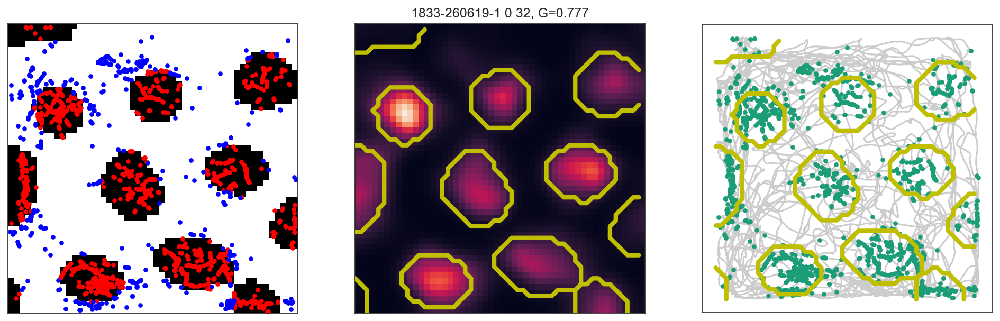

In [307]:
_ = compute_field_spikes(baseline_i.sort_values('gridness', ascending=False).iloc[18], plot=True)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


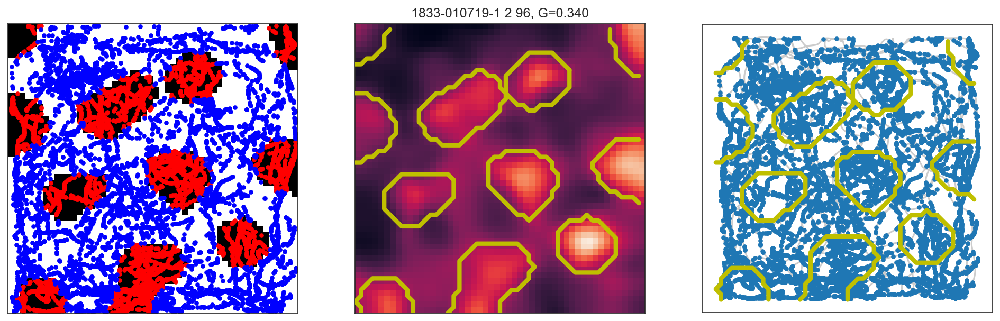

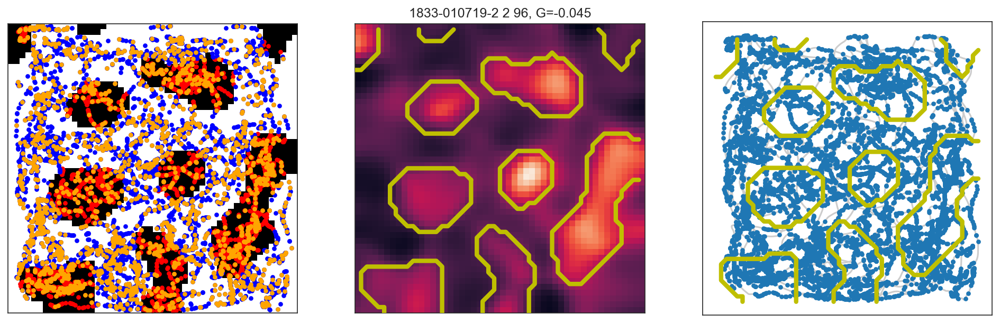

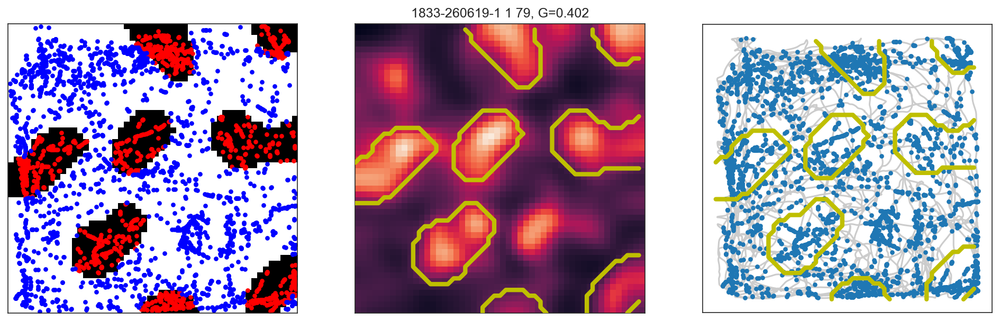

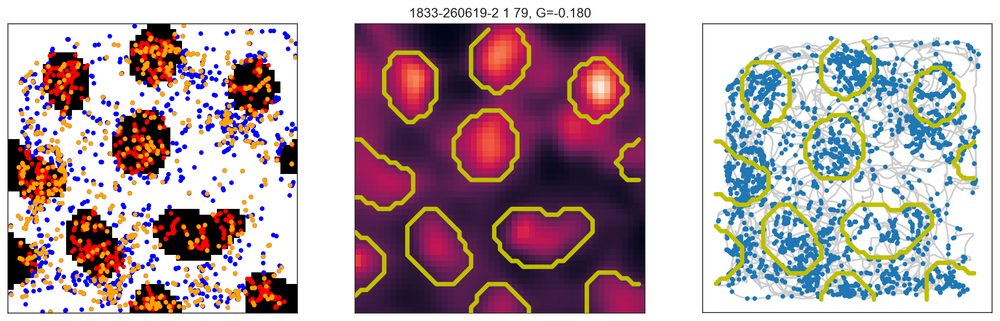

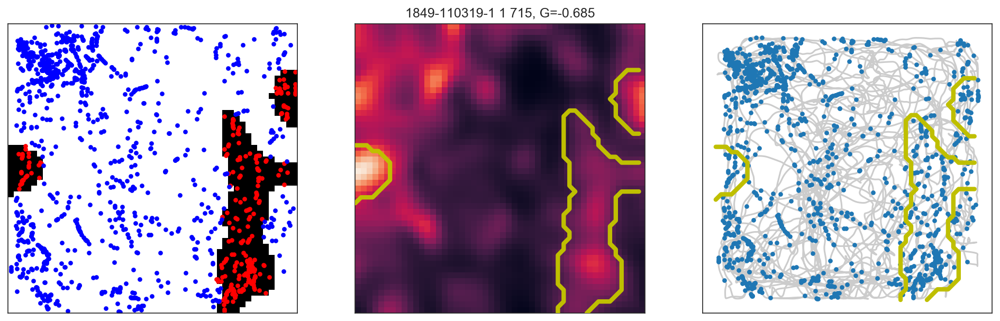

...

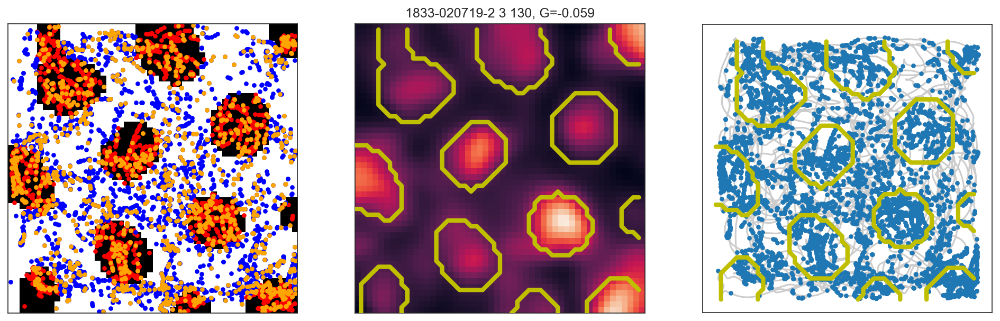

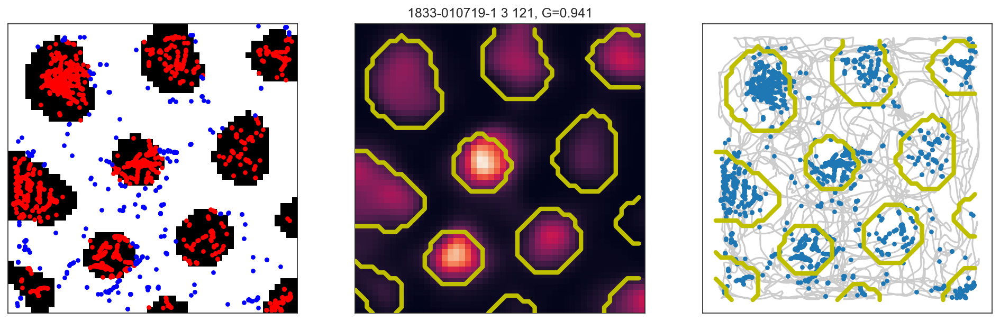

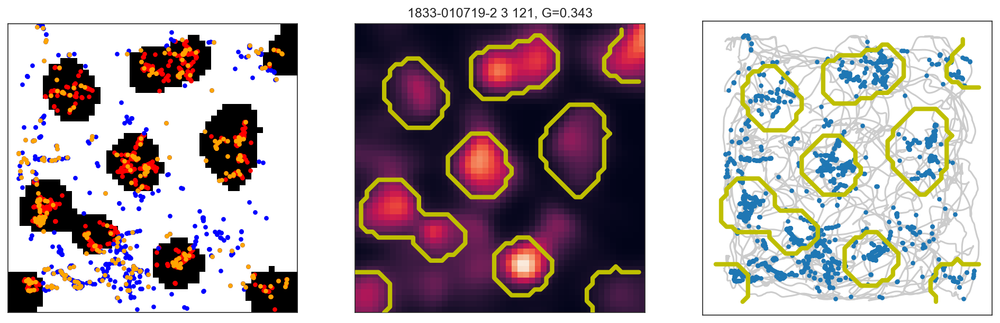

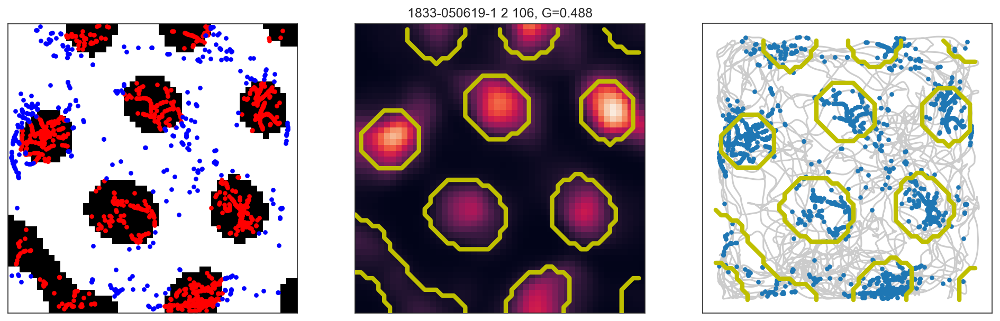

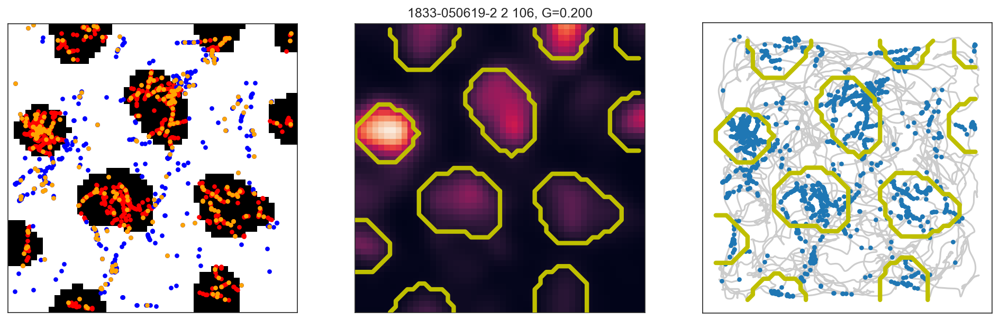

In [207]:
iter_base = baseline_i_sub.sort_values('unit_day', ascending=False).itertuples()
iter_stim = stimulated_11_sub.sort_values('unit_day', ascending=False).itertuples()
for row_base, row_stim in zip(iter_base, iter_stim):
    fields,_,_ = compute_field_spikes(row_base, plot=True)
    compute_field_spikes(row_stim, plot=True)#, surrogate_fields=fields)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


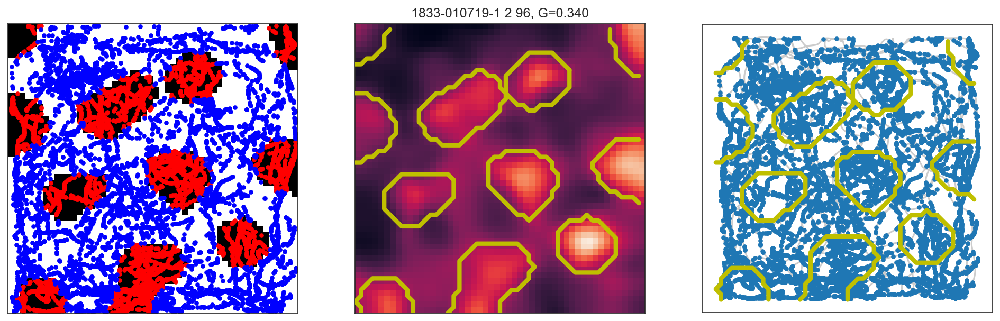

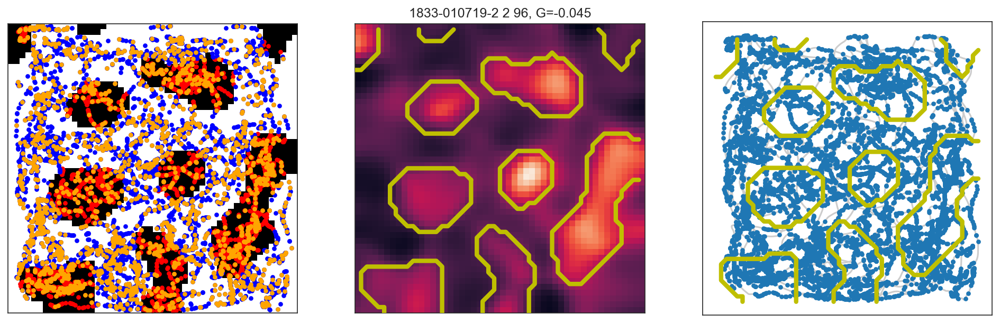

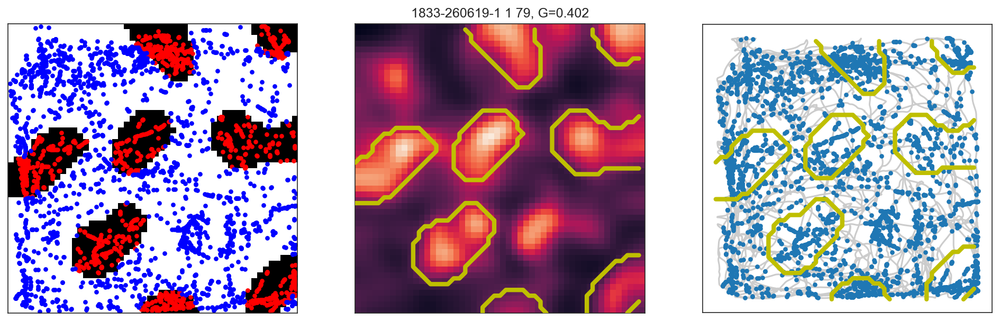

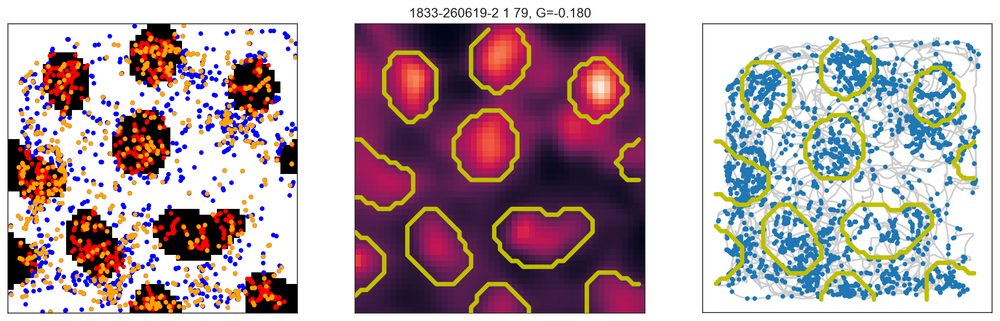

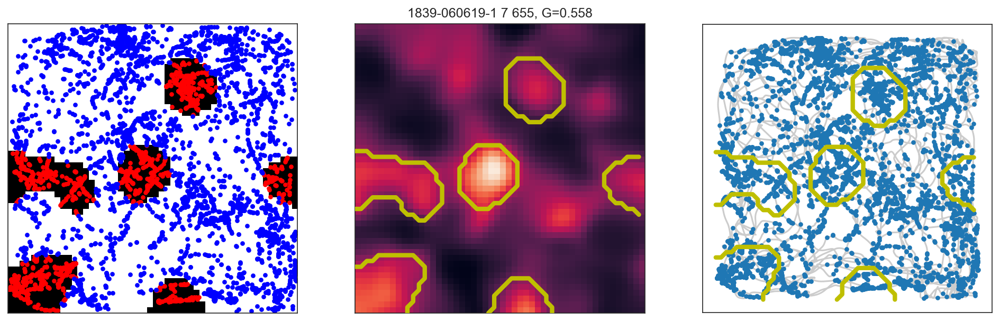

...

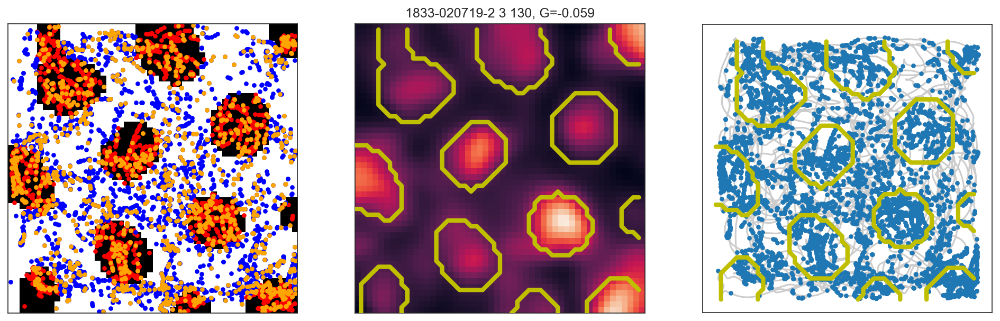

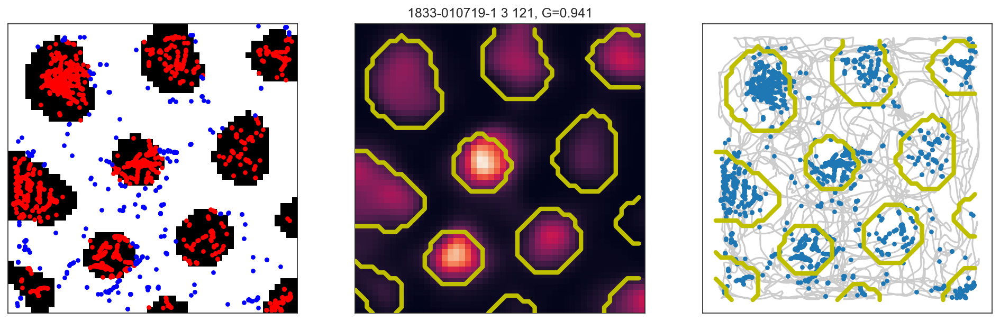

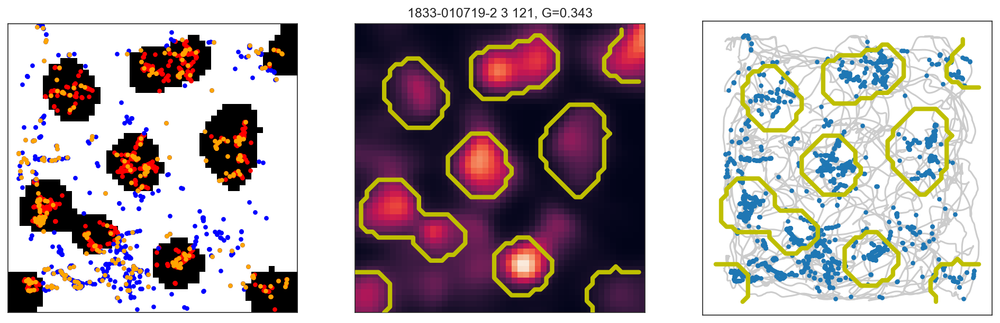

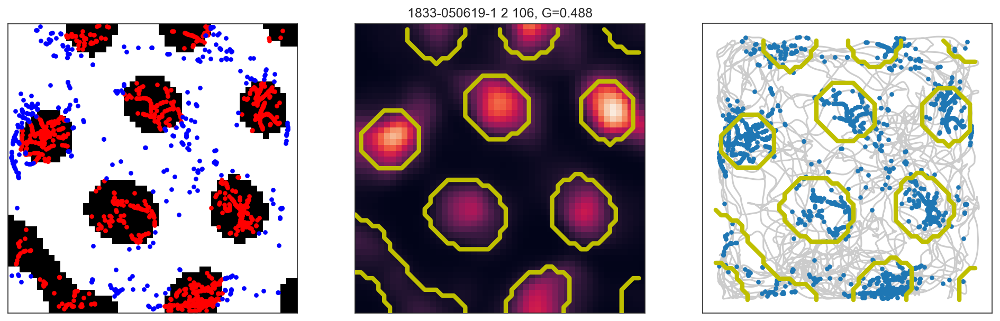

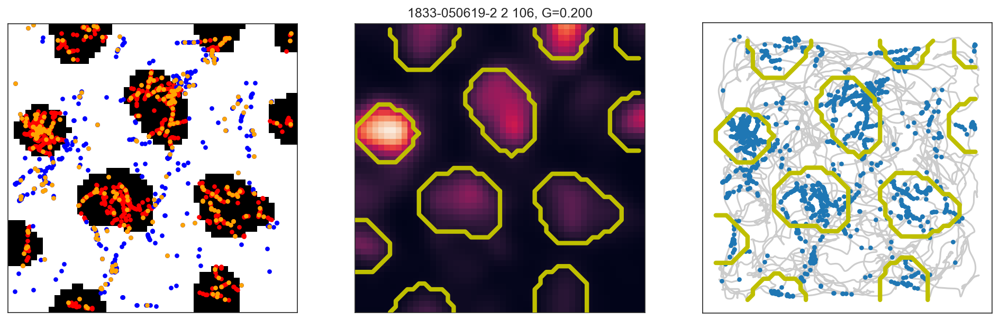

In [186]:
iter_base = baseline_i_sub.sort_values('unit_day', ascending=False).itertuples()
iter_stim = stimulated_11_sub.sort_values('unit_day', ascending=False).itertuples()
for row_base, row_stim in zip(iter_base, iter_stim):
    fields,_,_ = compute_field_spikes(row_base, plot=True)
    compute_field_spikes(row_stim, plot=True)#, surrogate_fields=fields)

# analysis stim vs stim

In [ ]:
# alessio make new one qith both 11 and 30 and the right colors plus in between period

In [81]:
plt.rc('axes', titlesize=12)
plt.rcParams.update({
    'font.size': 12, 
    'figure.figsize': (5, 2), 
    'figure.dpi': 150
})

plot_stim_field_spikes(
    stimulated_11.sort_values('gridness', ascending=False).iloc[18],
    colors=['#2166ac', '#b2182b']#['#1b9e77','#d95f02']
)
fig = plt.gcf()
figname = 'stim_field_spikes_example'
fig.savefig(
    output_path / 'figures' / f'{figname}.png', 
    bbox_inches='tight', transparent=True)
fig.savefig(
    output_path / 'figures' / f'{figname}.svg', 
    bbox_inches='tight', transparent=True)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [154]:
ilocs = range(10)
for iloc in ilocs:
    plot_stim_field_spikes_in_between(
        stimulated_11.sort_values('gridness', ascending=False).iloc[iloc],
        colors=['#1b9e77','#d95f02', 'C0'] #['#1b9e77','#d95f02']
    )
    fig = plt.gcf()    
    figname = f'stim_field_in_between_11Hz_example_{iloc}'
    fig.savefig(
        output_path / 'figures' / f'{figname}.png', 
        bbox_inches='tight', transparent=True)
    fig.savefig(
        output_path / 'figures' / f'{figname}.svg', 
        bbox_inches='tight', transparent=True)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 11.0Hz


In [155]:
ilocs = range(10)

for iloc in ilocs:
    plot_stim_field_spikes_in_between(
        stimulated_30.sort_values('gridness', ascending=False).iloc[iloc], t1=-10, t2=40, z1_between=20, 
        colors=['#7570b3', '#e7298a', 'C0'] #['#1b9e77','#d95f02']
    )
    fig = plt.gcf()
    figname = f'stim_field_in_between_30Hz_example_{iloc}'
    fig.savefig(
        output_path / 'figures' / f'{figname}.png', 
        bbox_inches='tight', transparent=True)
    fig.savefig(
        output_path / 'figures' / f'{figname}.svg', 
        bbox_inches='tight', transparent=True)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

Stim frequency = 30.0Hz


In [147]:
output_path.absolute()

PosixPath('/home/mikkel/apps/expipe-project/septum-mec/notebooks/output/spikes-in-field-in-between')

In [163]:
results_stim_stim_11 = []
z1_in_between=15e-3
z2_in_between=5e-3
z1_base=-5e3
z2_base=5e-3
z1_stim=5e-3
z2_stim=11e-3
for row_stim in stimulated_11.itertuples():
    _, base_in_field, between_in_field, stim_in_field = compute_field_spikes_in_between(
        row_stim, z1_base=z1_base, z2_base=z2_base, z1_stim=z1_stim, z2_stim=z2_stim, z1_between=z1_in_between, z2_between=z2_in_between)
    
    results_stim_stim_11.append({
        'base_in_field': 1 - base_in_field.mean(),
        'inbetween_in_field': 1 - between_in_field.mean(),
        'stim_in_field': 1 - stim_in_field.mean(),
    })
#     break

In [164]:
results_stim_stim_11 = pd.DataFrame(results_stim_stim_11)
results_stim_stim_11

,base_in_field,inbetween_in_field,stim_in_field
0,0.584628,0.578145,0.678867
1,0.769904,0.764277,0.727273
2,0.729418,0.714286,0.741722
3,0.307987,0.274247,0.388792
4,0.460233,0.449492,0.528596
5,0.690461,0.662837,0.770170
6,0.495020,0.458097,0.576505
7,0.712878,0.710668,0.744382
8,0.320308,0.313225,0.413793
9,0.549757,0.569131,0.623261


In [165]:
# results_stim_stim_30 = []
# z1_in_between=20e-3
# z2_in_between=5e-3
# z1_base=-5e3
# z2_base=5e-3
# for row_stim in stimulated_30.itertuples():
#     _, _, base_in_field = compute_field_spikes(
#         row_stim, z1=z1_base, z2=z2_base)
#     _, _, stim_in_field = compute_field_spikes_in_between(
#         row_stim, z1=z1_in_between, z2=z2_in_between)
    
#     results_stim_stim_30.append({
#         'base_in_field': 1 - base_in_field.mean(),
#         'inbetween_in_field': 1 - stim_in_field.mean()
#     })
# #     break
results_stim_stim_30 = []
z1_in_between=20e-3
z2_in_between=5e-3
z1_base=-5e3
z2_base=5e-3
z1_stim=5e-3
z2_stim=11e-3
for row_stim in stimulated_30.itertuples():
    _, base_in_field, between_in_field, stim_in_field = compute_field_spikes_in_between(
        row_stim, z1_base=z1_base, z2_base=z2_base, z1_stim=z1_stim, z2_stim=z2_stim, z1_between=z1_in_between, z2_between=z2_in_between)
    
    results_stim_stim_30.append({
        'base_in_field': 1 - base_in_field.mean(),
        'inbetween_in_field': 1 - between_in_field.mean(),
        'stim_in_field': 1 - stim_in_field.mean(),
    })
#     break

In [166]:
results_stim_stim_30 = pd.DataFrame(results_stim_stim_30)
results_stim_stim_30

,base_in_field,inbetween_in_field,stim_in_field
0,0.556642,0.581395,0.400000
1,0.327512,0.228571,0.321023
2,0.527730,0.458647,0.579270
3,0.638557,0.546961,0.636975
4,0.361515,0.273469,0.378876
5,0.666123,0.625796,0.675090
6,0.559489,0.516060,0.536465
7,0.400501,0.369239,0.433108
8,0.608701,0.572282,0.655920
9,0.588004,0.570416,0.543882


In [167]:
results_stim_stim_all = pd.concat([results_stim_stim_11, results_stim_stim_30])
results_stim_stim_all

,base_in_field,inbetween_in_field,stim_in_field
0,0.584628,0.578145,0.678867
1,0.769904,0.764277,0.727273
2,0.729418,0.714286,0.741722
3,0.307987,0.274247,0.388792
4,0.460233,0.449492,0.528596
...,...,...,...
30,0.532557,0.543478,0.579110
31,0.406227,0.310078,0.383289
32,0.283459,0.383648,0.363636
33,0.387523,0.371148,0.446855


In [168]:
np.max(results_stim_stim_all.inbetween_in_field)

0.7956789240234654

In [47]:
output_path

PosixPath('output/spikes-in-field-in-between')

In [211]:
def violinplot2(data, xticks, colors, fontsize=15, label_rotation=45):
    pos = [i * 0.6 for i in range(len(data))]
    violins = plt.violinplot(data, pos, showmeans=True, showextrema=False)
    
    for i, b in enumerate(violins['bodies']):
        b.set_color(colors[i])
        b.set_alpha (0.8)

 

    # for i, body in enumerate(violins['cbars']):
    #     body.set_color('C{}'.format(i))

 

    for category in ['cbars', 'cmins', 'cmaxes', 'cmedians', 'cmeans']:
        if category in violins:
            violins[category].set_color(['k', 'k'])
            violins[category].set_linewidth(2.0)
    plt.xticks(pos, xticks, rotation=label_rotation, fontsize=fontsize)
    plt.yticks(fontsize=fontsize)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

In [212]:
plt.rc('axes', titlesize=12)
plt.rcParams.update({
    'font.size': 12, 
    'figure.figsize': (3.4, 6), 
    'figure.dpi': 150
})

# fig = plt.figure()
# violinplot(
#     results_stim_stim_all.base_in_field, 
#     results_stim_stim_all.stim_in_field, 
#     results_stim_stim_all.inbetween_in_field, 
#     colors=None,
#     xticks=["Baseline  ", "Stimulated",  "  Between"],
#     test='wilcoxon'
# )
# figname = 'stim_field_between_spikes_combined_3'
# fig.savefig(
#     output_path / 'figures' / f'{figname}.png', 
#     bbox_inches='tight', transparent=True)
# fig.savefig(
#     output_path / 'figures' / f'{figname}.svg', 
#     bbox_inches='tight', transparent=True)

# 11
fig = plt.figure()
violinplot2(
    [results_stim_stim_11.base_in_field, 
    results_stim_stim_11.stim_in_field, 
    results_stim_stim_11.inbetween_in_field],
    colors=['#1b9e77','#d95f02', "C0"],
    xticks=["Pre", "Resp",  "Between"],
    label_rotation=0,
#     test='wilcoxon'
)
figname = 'stim_field_between_spikes_11_3'
fig.savefig(
    output_path / 'figures' / f'{figname}.png', 
    bbox_inches='tight', transparent=True)
fig.savefig(
    output_path / 'figures' / f'{figname}.svg', 
    bbox_inches='tight', transparent=True)
    
# 30
fig = plt.figure()
violinplot2(
    [results_stim_stim_30.base_in_field,
    results_stim_stim_30.stim_in_field, 
    results_stim_stim_30.inbetween_in_field],
    colors=['#7570b3', '#e7298a', "C0"],
    xticks=["Pre", "Resp",  "Between"],
    label_rotation=0,
#     test='wilcoxon'
)
figname = 'stim_field_between_spikes_30_3'
fig.savefig(
    output_path / 'figures' / f'{figname}.png', 
    bbox_inches='tight', transparent=True)
fig.savefig(
    output_path / 'figures' / f'{figname}.svg', 
    bbox_inches='tight', transparent=True)
    

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [213]:
output_path.absolute()

PosixPath('/home/mikkel/apps/expipe-project/septum-mec/notebooks/output/spikes-in-field-in-between')

In [193]:
def summarize(data):
    return "{:.2f} ± {:.2f} ({})".format(data.mean(), data.sem(), sum(~np.isnan(data)))


def Wilcoxon(df, keys):
    '''
    Wilcoxon
    '''
    Uvalue, pvalue = scipy.stats.wilcoxon(
        df[keys[0]].dropna(), 
        df[keys[1]].dropna(),
        alternative='two-sided')

    return "{:.2f}, {:.5f}".format(Uvalue, pvalue)

In [194]:
results_stim_stim_all.base_in_field.agg(summarize)

'0.48 ± 0.02 (85)'

In [44]:
output_path

PosixPath('output/spikes-in-field-in-between')

In [195]:
stat = pd.DataFrame()

stat['Combined'] = results_stim_stim_all.agg(summarize)
stat['11 Hz'] = results_stim_stim_11.agg(summarize)
stat['30 Hz'] = results_stim_stim_30.agg(summarize)

stat.loc['wilcoxon_base_between', 'Combined'] = Wilcoxon(results_stim_stim_all, ['base_in_field', 'inbetween_in_field'])
stat.loc['wilcoxon_base_stim', 'Combined'] = Wilcoxon(results_stim_stim_all, ['base_in_field', 'stim_in_field'])
stat.loc['wilcoxon_stim_between', 'Combined'] = Wilcoxon(results_stim_stim_all, ['base_in_field', 'inbetween_in_field'])


stat.loc['wilcoxon_base_between', '11 Hz'] = Wilcoxon(results_stim_stim_11, ['base_in_field', 'inbetween_in_field'])
stat.loc['wilcoxon_base_stim', '11 Hz'] = Wilcoxon(results_stim_stim_11, ['base_in_field', 'stim_in_field'])
stat.loc['wilcoxon_stim_between', '11 Hz'] = Wilcoxon(results_stim_stim_11, ['base_in_field', 'inbetween_in_field'])


stat.loc['wilcoxon_base_between', '30 Hz'] = Wilcoxon(results_stim_stim_30, ['base_in_field', 'inbetween_in_field'])
stat.loc['wilcoxon_base_stim', '30 Hz'] = Wilcoxon(results_stim_stim_30, ['base_in_field', 'stim_in_field'])
stat.loc['wilcoxon_stim_between', '30 Hz'] = Wilcoxon(results_stim_stim_30, ['base_in_field', 'inbetween_in_field'])
    
stat.to_latex(output_path / "statistics" / "statistics_3.tex")
stat.to_csv(output_path / "statistics" / "statistics_3.csv")

In [197]:
stat

,Combined,11 Hz,30 Hz
base_in_field,0.48 ± 0.02 (85),0.48 ± 0.02 (50),0.49 ± 0.02 (35)
inbetween_in_field,0.45 ± 0.02 (85),0.45 ± 0.02 (50),0.45 ± 0.02 (35)
stim_in_field,0.53 ± 0.02 (85),0.53 ± 0.02 (50),0.52 ± 0.02 (35)
wilcoxon_base_between,"466.00, 0.00000","162.00, 0.00000","82.00, 0.00014"
wilcoxon_base_stim,"334.00, 0.00000","66.00, 0.00000","104.00, 0.00055"
wilcoxon_stim_between,"466.00, 0.00000","162.00, 0.00000","82.00, 0.00014"


# more in baseline than response

In [247]:
wilcoxon(results_stim_stim_11.base_in_field - results_stim_stim_11.stim_in_field)

WilcoxonResult(statistic=35.0, pvalue=6.155288245645252e-11)

In [248]:
wilcoxon(results_stim_stim_11.base_in_field - results_stim_stim_11.stim_in_field, alternative='less')

WilcoxonResult(statistic=35.0, pvalue=3.077644122822626e-11)

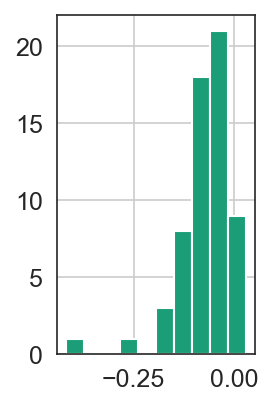

In [249]:
(results_stim_stim_11.base_in_field - results_stim_stim_11.stim_in_field).hist()

In [251]:
(results_stim_stim_11.base_in_field - results_stim_stim_11.stim_in_field).median()

-0.0628016121809225

# analysis baseline stim

In [188]:
iter_base = baseline_i_sub.sort_values('unit_day', ascending=False).itertuples()
iter_stim = stimulated_11_sub.sort_values('unit_day', ascending=False).itertuples()
results = []
z1=5e-3
z2=11e-3
# z1=0
# z2=5e-3
for row_base, row_stim in zip(iter_base, iter_stim):
    base_fields, base_in_field, _ = compute_field_spikes(
        row_base, z1=z1, z2=z2)
    stim_fields, stim_in_field, stim_stim_in_field = compute_field_spikes(
        row_stim, z1=z1, z2=z2)
    results.append({
        'base_in_field': base_in_field.mean(),
        'stim_in_field': stim_in_field.mean(), 
        'stim_stim_in_field': stim_stim_in_field.mean(),
        'gridness_base': row_base.gridness,
        'gridness_stim': row_stim.gridness,
        'action_base': row_base.action,
        'action_stim': row_stim.action
    })
#     break

In [189]:
results = pd.DataFrame(results)
results

,base_in_field,stim_in_field,stim_stim_in_field,gridness_base,gridness_stim,action_base,action_stim
0,0.414166,0.428529,0.361044,0.339934,-0.045053,1833-010719-1,1833-010719-2
1,0.404667,0.477324,0.419231,0.401503,-0.179613,1833-260619-1,1833-260619-2
2,0.280399,0.384092,0.321133,0.557819,0.917221,1839-060619-1,1839-060619-3
3,0.815385,0.745888,0.657431,0.532037,0.397104,1833-010719-1,1833-010719-2
4,0.481623,0.399033,0.300733,0.282903,0.001879,1834-220319-1,1834-220319-2
5,0.734889,0.681776,0.611208,0.776775,0.869214,1833-260619-1,1833-260619-2
6,0.280964,0.449841,0.416287,0.317565,0.344708,1833-200619-1,1833-200619-2
7,0.739768,0.729892,0.676768,1.101447,0.976654,1833-200619-1,1833-200619-2
8,0.599141,0.549244,0.487360,0.215937,-0.201297,1833-260619-1,1833-260619-2
9,0.826862,0.732639,0.663934,0.855641,0.554912,1833-120619-1,1833-120619-2


# more in baseline than response

In [190]:
wilcoxon(results.base_in_field - results.stim_stim_in_field)

WilcoxonResult(statistic=12.0, pvalue=0.011007912955186742)

In [191]:
wilcoxon(results.base_in_field - results.stim_stim_in_field, alternative='greater')

WilcoxonResult(statistic=93.0, pvalue=0.005503956477593371)

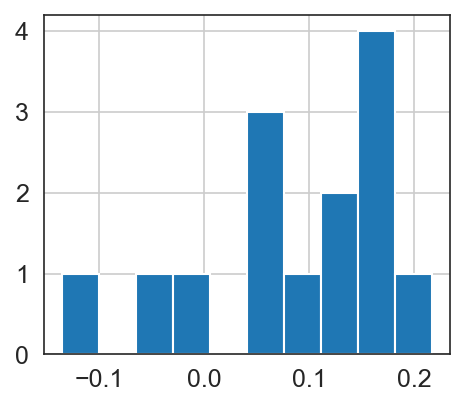

In [192]:
(results.base_in_field - results.stim_stim_in_field).hist()

In [153]:
(results.base_in_field - results.stim_stim_in_field).median()

0.09670222033391301

# more in baseline than total of stim

In [150]:
wilcoxon(results.base_in_field - results.stim_in_field)

WilcoxonResult(statistic=96.0, pvalue=0.32207523283525596)

In [151]:
wilcoxon(results.base_in_field - results.stim_in_field, alternative='greater')

WilcoxonResult(statistic=157.0, pvalue=0.16103761641762798)

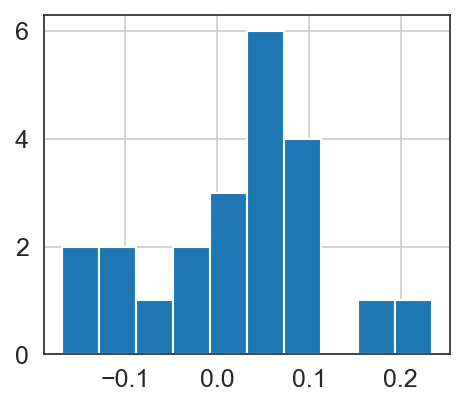

In [152]:
(results.base_in_field - results.stim_in_field).hist()

# greater than chance

In [143]:
wilcoxon(results.base_in_field - 0.5, alternative='greater') # most fall within the field

WilcoxonResult(statistic=160.0, pvalue=0.13838602372323838)

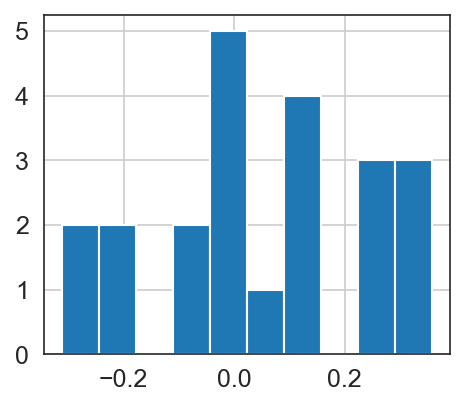

In [144]:
(results.base_in_field - 0.5).hist()

In [145]:
wilcoxon(results.stim_stim_in_field - 0.5, alternative='greater') # most fall within the field

WilcoxonResult(statistic=101.0, pvalue=0.7961290925328811)

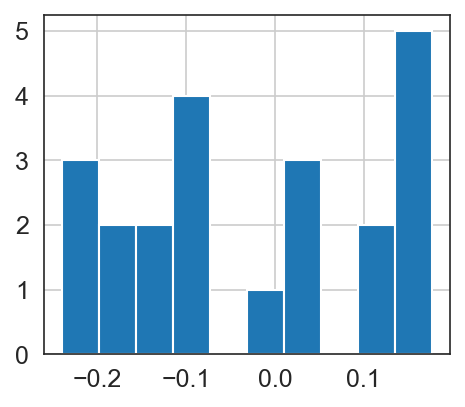

In [146]:
(results.stim_stim_in_field - 0.5).hist()

In [139]:
plt.rc('axes', titlesize=12)
plt.rcParams.update({
    'font.size': 12, 
    'figure.figsize': (3.5, 3), 
    'figure.dpi': 150
})

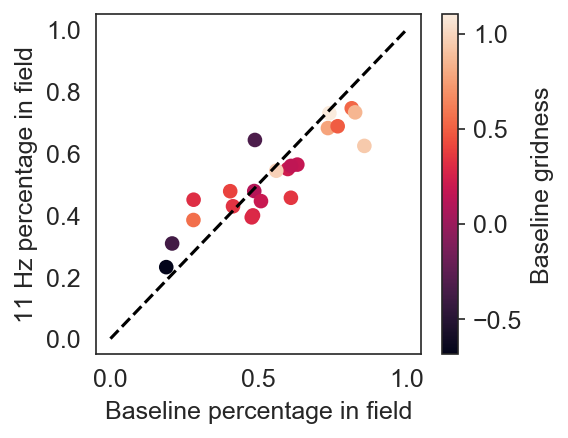

In [142]:
fig, ax = plt.subplots(1,1)
sc = ax.scatter(
    results.base_in_field, results.stim_in_field,
    c=results.gridness_base
#     c=results.gridness_stim
)
ax.plot([0, 1], [0,1], 'k--')
plt.xlabel('Baseline percentage in field')
plt.ylabel('11 Hz percentage in field')
cb = plt.colorbar(mappable=sc, cax=None, ax=ax)
cb.ax.yaxis.set_ticks_position('right')
cb.set_label('Baseline gridness')

In [64]:
baseline_i.merge(stimulated_11, on='unit_day', suffixes=['_base', '_stim'])

,action_base,baseline_base,entity_base,frequency_base,i_base,ii_base,session_base,stim_location_base,stimulated_base,tag_base,...,information_rate_stim,information_specificity_stim,head_mean_ang_stim,head_mean_vec_len_stim,spacing_stim,orientation_stim,t_e_peak_stim,p_e_peak_stim,t_i_peak_stim,p_i_peak_stim
0,1833-260619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,1.066774,0.302404,5.539069,0.103552,0.342142,10.007980,NaN,NaN,NaN,NaN
1,1833-260619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.553675,0.106860,5.284125,0.151640,0.361430,14.743563,NaN,NaN,NaN,NaN
2,1833-260619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.914806,0.085579,5.650586,0.102010,0.477803,51.952957,NaN,NaN,NaN,NaN
3,1833-260619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.681461,0.154506,2.601550,0.015570,0.343784,0.000000,NaN,NaN,NaN,NaN
4,1833-010719-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,1.021932,0.349152,1.196446,0.137136,0.344403,13.240520,NaN,NaN,NaN,NaN
5,1833-010719-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.735341,0.043588,3.418123,0.055051,0.405348,46.468801,NaN,NaN,NaN,NaN
6,1833-010719-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.857698,0.269769,2.340344,0.137602,0.351311,13.240520,NaN,NaN,NaN,NaN
7,1833-050619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,1.442780,0.585854,2.321438,0.220139,0.387257,5.440332,NaN,NaN,NaN,NaN
8,1833-050619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.862973,0.183897,0.069331,0.091981,0.366146,9.462322,NaN,NaN,NaN,NaN
9,1833-050619-1,True,1833,NaN,True,False,1,NaN,False,baseline i,...,0.873561,0.103053,3.668189,0.069408,0.434762,70.559965,NaN,NaN,NaN,NaN


# save to expipe

In [53]:
action = project.require_action("spikes-in-field")

In [54]:
copy_tree(output_path, str(action.data_path()))

['/media/storage/expipe/septum-mec/actions/spikes-in-field/data/statistics/statistics.tex',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/statistics/statistics.csv',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_30.svg',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_example.svg',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_11.svg',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_example.png',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_combined.svg',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_combined.png',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_30.png',
 '/media/storage/expipe/septum-mec/actions/spikes-in-field/data/figures/stim_field_spikes_11.png']

In [55]:
septum_mec.analysis.registration.store_notebook(action, "20_spikes_in_field.ipynb")